In [ ]:
import functools
import os

from matplotlib import gridspec
import matplotlib.pylab as plt
import numpy as np
import tensorflow as tf
import tensorflow_hub as hub

print("TF Version: ", tf.__version__)
print("TF Hub version: ", hub.__version__)
print("Eager mode enabled: ", tf.executing_eagerly())
print("GPU available: ", tf.config.list_physical_devices('GPU'))

import time
from tensorflow.keras.preprocessing.image import save_img

TF Version:  2.14.0
TF Hub version:  0.15.0
Eager mode enabled:  True
GPU available:  []


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

os.chdir('/content/drive/MyDrive/CIS5810/Final_Project/Fast Style Transfer for Arbitrary Styles')

Mounted at /content/drive


In [ ]:
def crop_center(image):
  """Returns a cropped square image."""
  shape = image.shape
  new_shape = min(shape[1], shape[2])
  offset_y = max(shape[1] - shape[2], 0) // 2
  offset_x = max(shape[2] - shape[1], 0) // 2
  image = tf.image.crop_to_bounding_box(
      image, offset_y, offset_x, new_shape, new_shape)
  return image

@functools.lru_cache(maxsize=None)
def load_image(image_path, image_size=(256, 256), preserve_aspect_ratio=True):
    """Loads and preprocesses images."""
    # Load and convert to float32 numpy array, add batch dimension, and normalize to range [0, 1].
    img = tf.io.decode_image(
        tf.io.read_file(image_path),
        channels=3, dtype=tf.float32)[tf.newaxis, ...]
    img = crop_center(img)
    img = tf.image.resize(img, image_size, preserve_aspect_ratio=True)
    return img

def show_n(images, titles=('',)):
  n = len(images)
  image_sizes = [image.shape[1] for image in images]
  w = (image_sizes[0] * 6) // 320
  plt.figure(figsize=(w * n, w))
  gs = gridspec.GridSpec(1, n, width_ratios=image_sizes)
  for i in range(n):
    plt.subplot(gs[i])
    plt.imshow(images[i][0], aspect='equal')
    plt.axis('off')
    plt.title(titles[i] if len(titles) > i else '')
  plt.show()

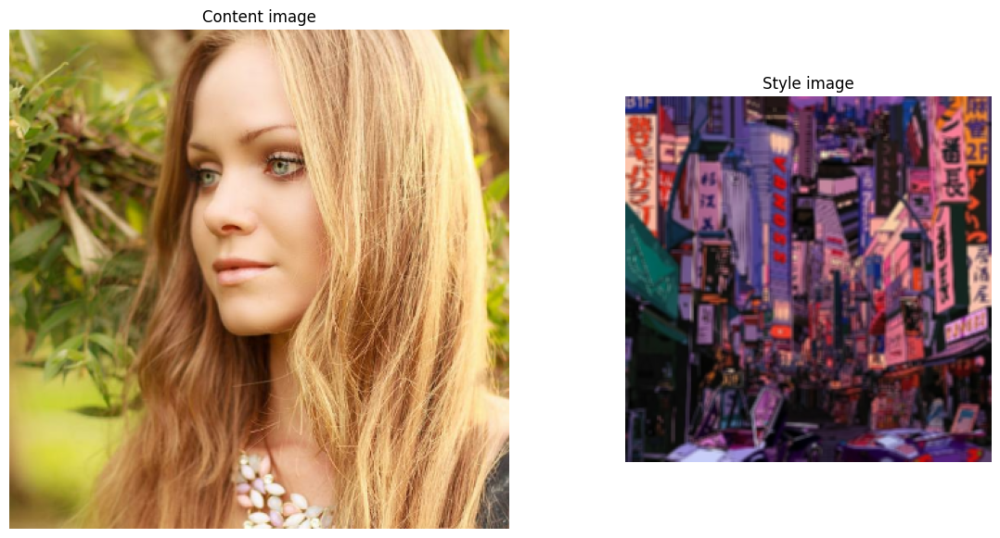

In [ ]:
# @title Load example images  { display-mode: "form" }

content_image_path = 'data/Content_Final/1_content.jpg'
style_image_path = 'data/Style_Final/modern.jpg'
output_image_size = 384

# The content image size can be arbitrary.
content_img_size = (output_image_size, output_image_size)
# The style prediction model was trained with image size 256 and it's the
# recommended image size for the style image (though, other sizes work as
# well but will lead to different results).
style_img_size = (256, 256)  # Recommended to keep it at 256.

content_image = load_image(content_image_path, content_img_size)
style_image = load_image(style_image_path, style_img_size)
style_image = tf.nn.avg_pool(style_image, ksize=[3,3], strides=[1,1], padding='SAME')
show_n([content_image, style_image], ['Content image', 'Style image'])

In [ ]:
# Load TF Hub module.
'''
hub_handle = 'https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2'
hub_module = hub.load(hub_handle)
'''
local_model_path = os.getcwd() + '/archive'

loaded_model = tf.saved_model.load(local_model_path)
# hub_module = hub.Module(loaded_model)


In [ ]:
# outputs = hub_module(content_image, style_image)
outputs = loaded_model(content_image, style_image)
stylized_image = outputs[0]

In [ ]:
# Stylize content image with given style image.
# This is pretty fast within a few milliseconds on a GPU.

# outputs = hub_module(tf.constant(content_image), tf.constant(style_image))
outputs = loaded_model(tf.constant(content_image), tf.constant(style_image))
stylized_image = outputs[0]

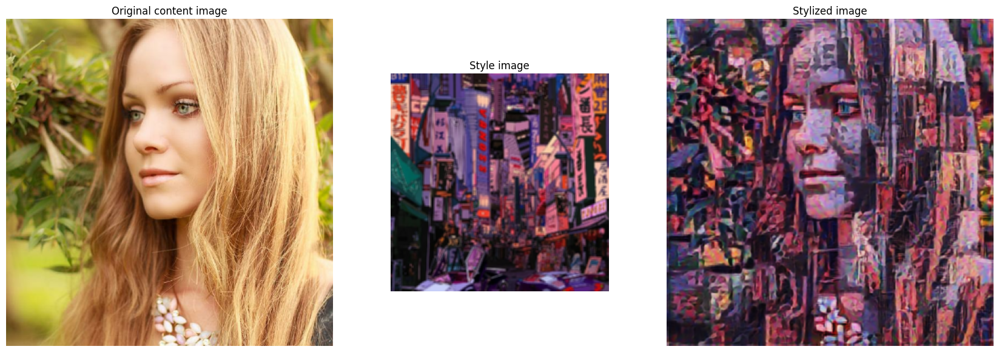

In [ ]:
# Visualize input images and the generated stylized image.

show_n([content_image, style_image, stylized_image], titles=['Original content image', 'Style image', 'Stylized image'])

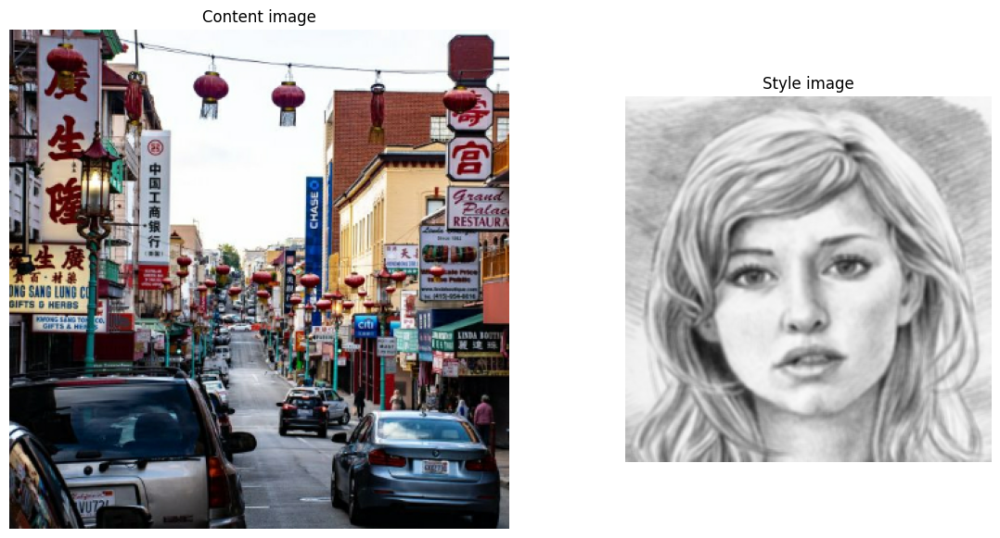

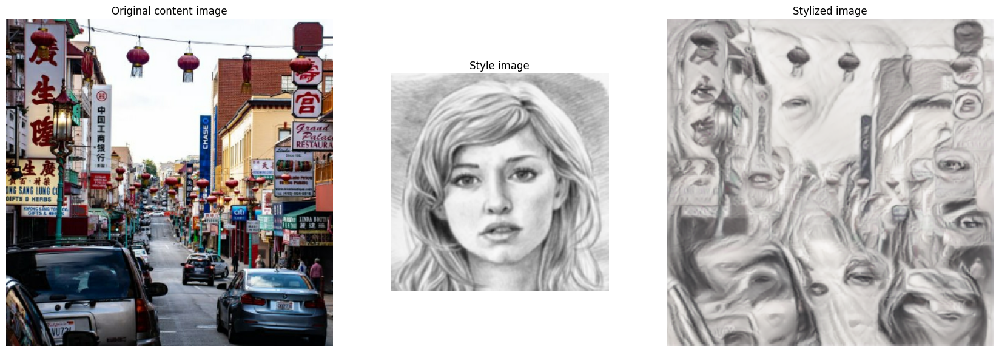

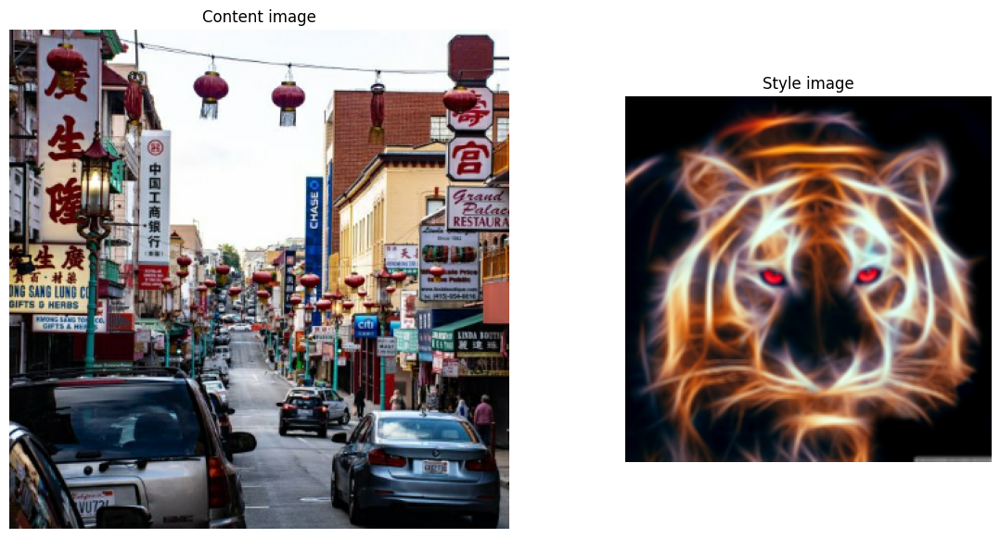

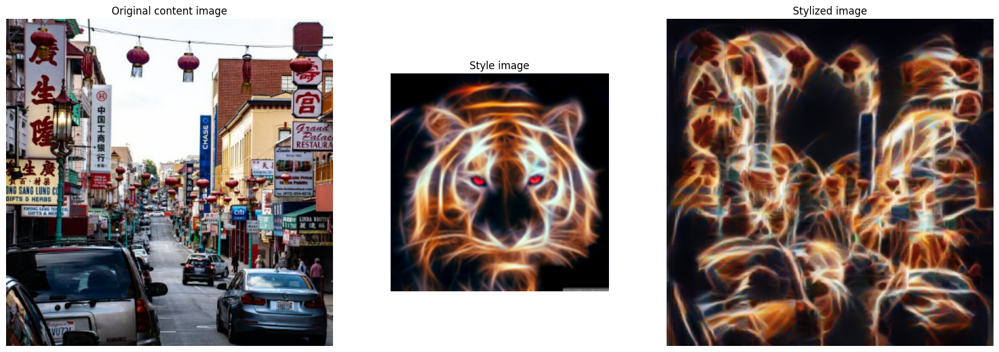

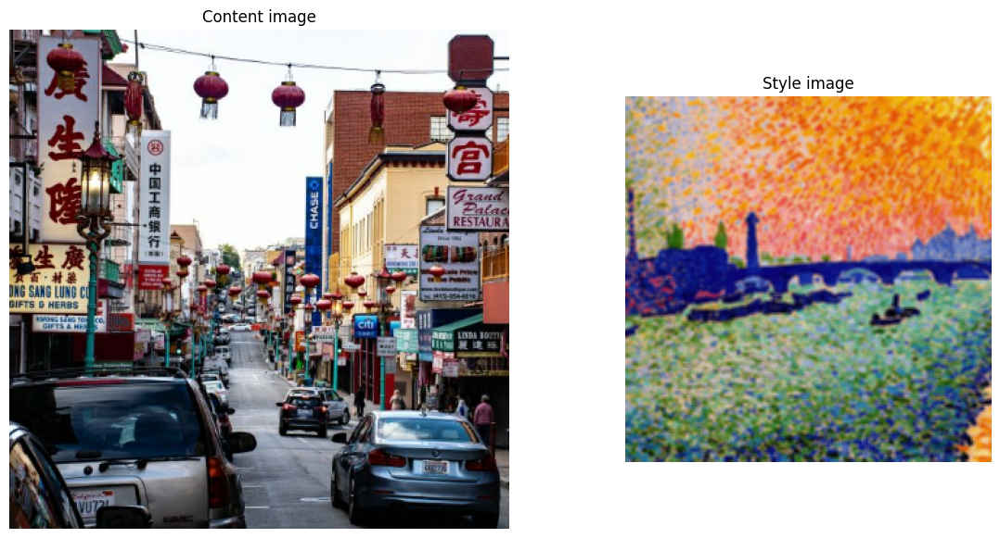

...

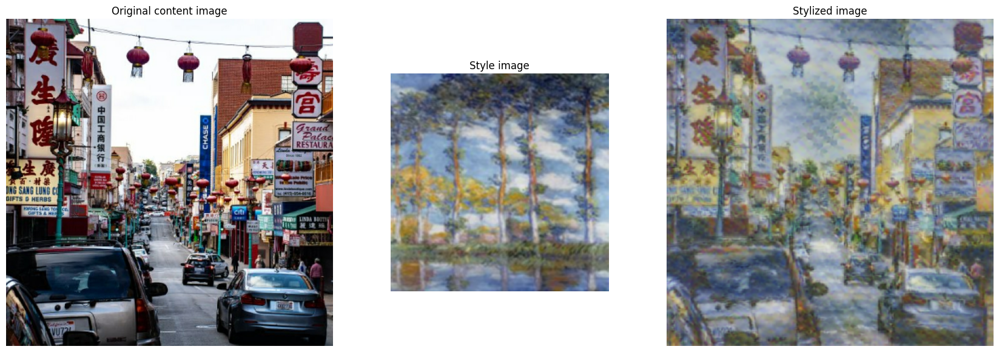

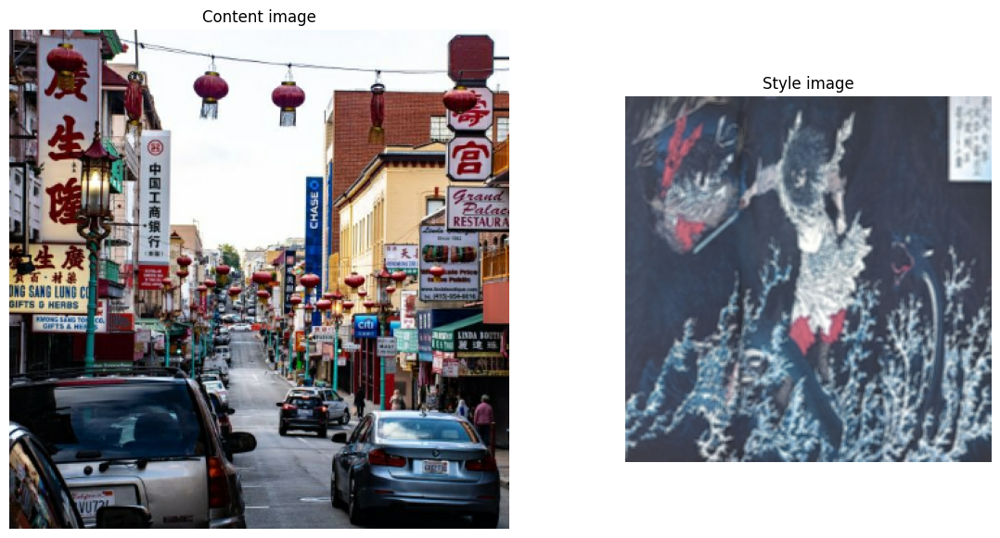

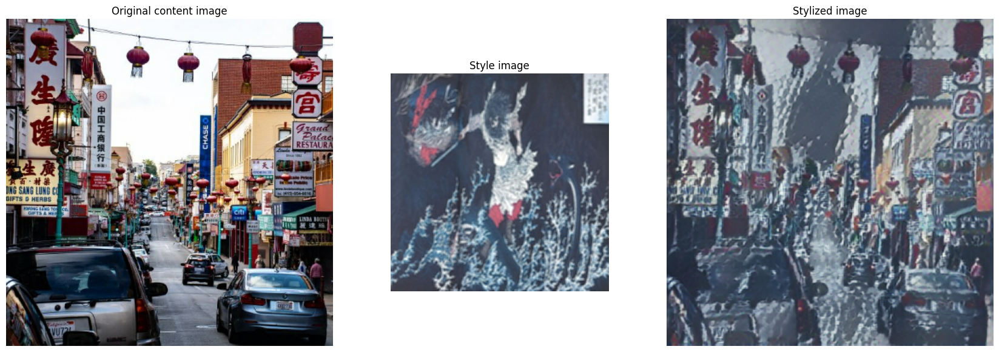

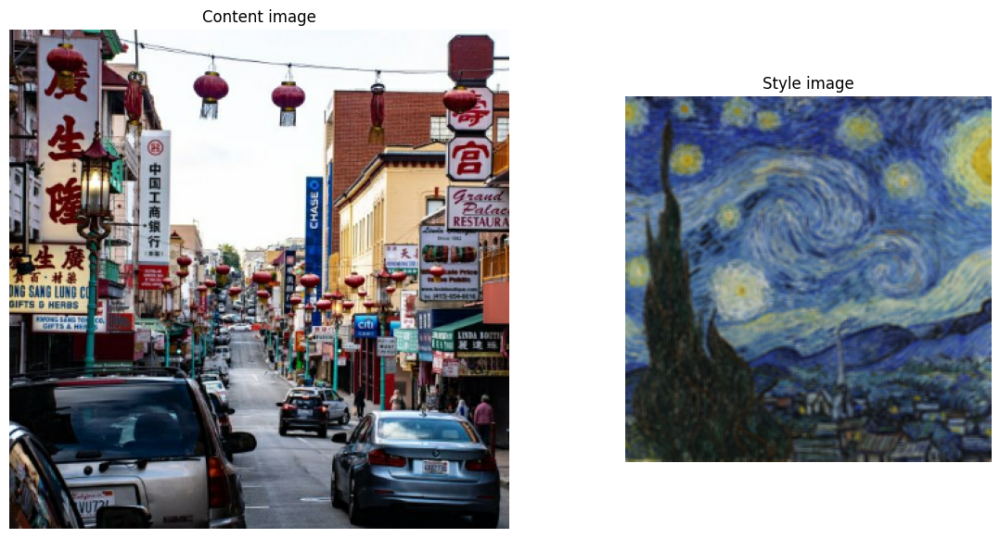

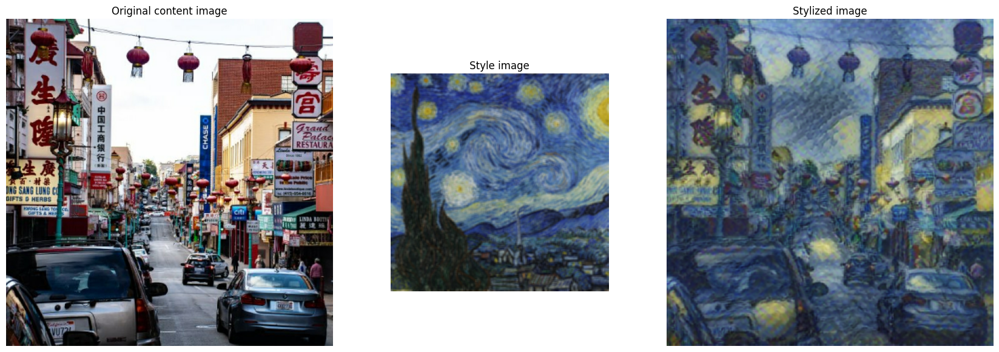

In [ ]:
styles = ['1_style', '2_style', 'andre', 'cezanne', 'modern', 'monet', 'ukiyoe', 'VanGogh']
contents = ['1_content', '2_content', 'Green_Sea_Turtle_grazing_seagrass', 'photo0', 'photo1', 'photo4', 'photo7', 'photo10']
# current_style = styles[4]
current_content = contents[3]

for current_style in styles:

    content_image_path = "data/Content_Final/" + current_content + ".jpg"
    style_image_path = "data/Style_Final/" + current_style + ".jpg"
    output_image_size = 384

    # The content image size can be arbitrary.
    content_img_size = (output_image_size, output_image_size)
    # The style prediction model was trained with image size 256 and it's the
    # recommended image size for the style image (though, other sizes work as
    # well but will lead to different results).
    style_img_size = (256, 256)  # Recommended to keep it at 256.

    content_image = load_image(content_image_path, content_img_size)
    style_image = load_image(style_image_path, style_img_size)
    style_image = tf.nn.avg_pool(style_image, ksize=[3,3], strides=[1,1], padding='SAME')
    show_n([content_image, style_image], ['Content image', 'Style image'])

    # Load TF Hub module.
    '''
    hub_handle = 'https://tfhub.dev/google/magenta/arbitrary-image-stylization-v1-256/2'
    hub_module = hub.load(hub_handle)
    '''
    local_model_path = os.getcwd() + '/archive'

    loaded_model = tf.saved_model.load(local_model_path)
    # hub_module = hub.Module(loaded_model)

    start_time = time.time()
    # outputs = hub_module(content_image, style_image)
    outputs = loaded_model(content_image, style_image)
    stylized_image = outputs[0]

    # Stylize content image with given style image.
    # This is pretty fast within a few milliseconds on a GPU.

    # outputs = hub_module(tf.constant(content_image), tf.constant(style_image))
    outputs = loaded_model(tf.constant(content_image), tf.constant(style_image))
    stylized_image = outputs[0]
    end_time = time.time()
    elapsed_time = end_time - start_time

    output_text = f"Image File: {current_content} under {current_style}\nTime Used: {elapsed_time:.1f} seconds\n\n"
    output_file_path = "data/time_memory_usage.txt"
    with open(output_file_path, "a") as file:
        file.write(output_text)

    # Visualize input images and the generated stylized image.

    show_n([content_image, style_image, stylized_image], titles=['Original content image', 'Style image', 'Stylized image'])

    output_image_path = "data/Output_Final_Compare_Content/" + current_content + ' under ' + current_style + ".jpg"
    save_img(output_image_path, np.squeeze(stylized_image, axis=0))

